<a href="https://colab.research.google.com/github/bartlos-1/deforestation-prediction/blob/main/Deforestation_Model_Pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import folium
import numpy as np
import ee
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.utils import resample
from scipy.ndimage import gaussian_filter

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Initialize Earth Engine
ee.Authenticate()
ee.Initialize(project = 'deforestation-450200')



In [153]:
roi = ee.Geometry.Polygon([
    [
        [-122.8, 48.9],
        [-113.5, 48.9],
        [-113.5, 54.5],
        [-122.8, 54.5],
        [-122.8, 48.9]
    ]
])

In [154]:
# Function to get median composite
def get_composite(start, end):
    return (
        ee.ImageCollection("COPERNICUS/S2")
        .filterBounds(roi)
        .filterDate(start, end)
        .filterMetadata("CLOUDY_PIXEL_PERCENTAGE", "less_than", 20)
        .select(["B2", "B3", "B4", "B8"])
        .median()
        .clip(roi)
    )

# Early and late composites
early = get_composite("2015-01-01", "2016-12-31")
late = get_composite("2022-01-01", "2023-12-31")

In [155]:
# Delta bands
delta_b4 = late.select("B4").subtract(early.select("B4")).rename("delta_B4")
delta_b8 = late.select("B8").subtract(early.select("B8")).rename("delta_B8")
ndvi_early = early.normalizedDifference(["B8", "B4"]).rename("NDVI_early")
ndvi_late = late.normalizedDifference(["B8", "B4"]).rename("NDVI_late")
delta_ndvi = ndvi_late.subtract(ndvi_early).rename("delta_NDVI")
# NDWI delta (moisture change)
ndwi_early = early.normalizedDifference(["B3", "B8"]).rename("NDWI_early")
ndwi_late = late.normalizedDifference(["B3", "B8"]).rename("NDWI_late")
delta_ndwi = ndwi_late.subtract(ndwi_early).rename("delta_NDWI")
# Full composite and vegetation indices
composite = get_composite("2015-01-01", "2023-12-31")
ndvi = composite.normalizedDifference(["B8", "B4"]).rename("NDVI")
ndwi = composite.normalizedDifference(["B3", "B8"]).rename("NDWI")


In [156]:
# Forest mask
gfc = ee.Image("UMD/hansen/global_forest_change_2023_v1_11").clip(roi)
treecover = gfc.select("treecover2000")
lossyear = gfc.select("lossyear")
loss = gfc.select("loss")        # 1 = forest loss occurred
gain = gfc.select("gain")        # 1 = forest gain occurred





In [161]:
# Elevation and slope
dem = ee.Image("USGS/SRTMGL1_003").select("elevation")
slope = ee.Terrain.slope(dem).rename("slope")
# NDVI texture (standard deviation)
ndvi_stddev_3x3 = ndvi.reduceNeighborhood(
    reducer=ee.Reducer.stdDev(),
    kernel=ee.Kernel.square(1) # 3x3 window
).rename("NDVI_stddev_3x3")

ndvi_stddev_5x5 = ndvi.reduceNeighborhood(
    reducer=ee.Reducer.stdDev(),
    kernel=ee.Kernel.square(2)  # 5x5 window
).rename("NDVI_stddev_5x5")

# Slope texture (standard deviation)
slope_stddev_3x3 = slope.reduceNeighborhood(
    reducer=ee.Reducer.stdDev(),
    kernel=ee.Kernel.square(1)
).rename("slope_stddev_3x3")

slope_stddev_5x5 = slope.reduceNeighborhood(
    reducer=ee.Reducer.stdDev(),
    kernel=ee.Kernel.square(2)
).rename("slope_stddev_5x5")

enhanced_image = composite \
    .addBands(ndvi) \
    .addBands(ndwi) \
    .addBands(delta_b4) \
    .addBands(delta_b8) \
    .addBands(delta_ndvi) \
    .addBands(dem.rename("elevation")) \
    .addBands(slope) \
    .addBands(ndvi_stddev_3x3) \
    .addBands(ndvi_stddev_5x5) \
    .addBands(slope_stddev_3x3) \
    .addBands(slope_stddev_5x5) \
    .addBands(delta_ndwi) \
    .addBands(gain.rename("gain")) \
    .addBands(loss.rename("loss"))
masked_image = enhanced_image.updateMask(treecover.gte(30))

In [183]:
def export_sample_to_drive_tiled(image, bands, base_roi, tile_count=2, scale=1000, num_samples=2000):
    coords = base_roi.bounds().coordinates().get(0).getInfo()
    xmin, ymin = coords[0][0], coords[0][1]
    xmax, ymax = coords[2][0], coords[2][1]

    x_step = (xmax - xmin) / tile_count
    y_step = (ymax - ymin) / tile_count

    lossyear = ee.Image("UMD/hansen/global_forest_change_2023_v1_11").select("lossyear")
    image = image.addBands(lossyear.rename("lossyear"))
    loss = gfc.select("loss")
    gain = gfc.select("gain")
    image = image.addBands(loss.rename("loss")).addBands(gain.rename("gain"))



    task_id = 1
    for i in range(tile_count):
        for j in range(tile_count):
            tile = ee.Geometry.Rectangle([
                xmin + j * x_step,
                ymin + i * y_step,
                xmin + (j + 1) * x_step,
                ymin + (i + 1) * y_step
            ])

            # Sample all forested pixels — filter/label in Python later
            sample = image.select(bands + ["loss"]) \
                .sample(region=tile, scale=scale, numPixels=num_samples, geometries=True, seed=task_id*100) \
                .limit(num_samples)
            task = ee.batch.Export.table.toDrive(
                collection=sample,
                description=f"tile_export_{task_id}",
                folder="earth_engine",
                fileNamePrefix=f"deforestation_tile_{task_id}",
                fileFormat="CSV"
            )
            task.start()
            print(f"✅ Exported tile {task_id} (all forest samples)")
            task_id += 1

    print("🚀 All exports started — label in pandas after download.")




In [184]:
bands = ["B2", "B3", "B4", "B8", "NDVI", "NDWI",
         "delta_B4", "delta_B8", "delta_NDVI",
         "delta_NDWI", "elevation", "slope","gain","NDVI_stddev_3x3","NDVI_stddev_5x5",
         "slope_stddev_3x3","slope_stddev_5x5"]


In [185]:
# Export sample data to Google Drive
# Export 4 tiles (2x2 grid) with 1000 samples each
export_sample_to_drive_tiled(masked_image, bands, roi, tile_count=4)

# After downloading CSV, use pandas to load and process locally
# Example (outside EE):
# import pandas as pd
# df = pd.read_csv("deforestation_data.csv")
# X = df[bands].values
# y = (df["lossyear"] >= 5).astype(int).values  # 5+ corresponds to year 2005+

✅ Exported tile 1 (all forest samples)
✅ Exported tile 2 (all forest samples)
✅ Exported tile 3 (all forest samples)
✅ Exported tile 4 (all forest samples)
✅ Exported tile 5 (all forest samples)
✅ Exported tile 6 (all forest samples)
✅ Exported tile 7 (all forest samples)
✅ Exported tile 8 (all forest samples)
✅ Exported tile 9 (all forest samples)
✅ Exported tile 10 (all forest samples)
✅ Exported tile 11 (all forest samples)
✅ Exported tile 12 (all forest samples)
✅ Exported tile 13 (all forest samples)
✅ Exported tile 14 (all forest samples)
✅ Exported tile 15 (all forest samples)
✅ Exported tile 16 (all forest samples)
🚀 All exports started — label in pandas after download.


In [187]:
import pandas as pd
import glob
import numpy as np

csv_files = glob.glob("/content/drive/MyDrive/earth_engine/deforestation_tile_*.csv")
df_list = [pd.read_csv(file) for file in csv_files]
df = pd.concat(df_list, ignore_index=True)

# ✅ Fix nulls and assign label

y = df["loss"].astype(int)
  # Convert to NumPy
X = df[bands].values  # Same row count as y


print(f"Total samples: {len(df)}")
print(f"Deforestation samples: {np.sum(y == 1)}")
print(f"No deforestation samples: {np.sum(y == 0)}")


Total samples: 22257
Deforestation samples: 6593
No deforestation samples: 15664


In [188]:
from sklearn.model_selection import train_test_split
from sklearn.utils import resample

# Split classes
X_defor = X[y == 1]
X_nondefor = X[y == 0]

# Downsample non-deforestation to match deforestation count
X_nondefor_down, y_nondefor = resample(
    X_nondefor, y[y == 0],
    replace=False,
    n_samples=len(X_defor),
    random_state=42
)

# Combine balanced dataset
X_bal = np.vstack([X_defor, X_nondefor_down])
y_bal = np.concatenate([y[y == 1], y_nondefor])



X_train, X_test, y_train, y_test = train_test_split(X_bal, y_bal, test_size=0.2, random_state=42)



In [191]:
import xgboost as xgb
from sklearn.metrics import accuracy_score

model = xgb.XGBClassifier(
    n_estimators=300,
    max_depth=6,
    learning_rate=0.05,
    subsample=0.8,
    colsample_bytree=0.8,
    min_child_weight=5,
    gamma=0.1,
    eval_metric='logloss',
    use_label_encoder=False
)


model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=True)

y_pred = model.predict(X_test)
print(f"✅ XGBoost Accuracy: {accuracy_score(y_test, y_pred):.2f}")



[0]	validation_0-logloss:0.68346
[1]	validation_0-logloss:0.67651


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [06:11:45] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-logloss:0.66779
[3]	validation_0-logloss:0.65989
[4]	validation_0-logloss:0.65360
[5]	validation_0-logloss:0.64736
[6]	validation_0-logloss:0.64088
[7]	validation_0-logloss:0.63507
[8]	validation_0-logloss:0.62964
[9]	validation_0-logloss:0.62524
[10]	validation_0-logloss:0.62181
[11]	validation_0-logloss:0.61745
[12]	validation_0-logloss:0.61268
[13]	validation_0-logloss:0.60870
[14]	validation_0-logloss:0.60592
[15]	validation_0-logloss:0.60293
[16]	validation_0-logloss:0.59973
[17]	validation_0-logloss:0.59736
[18]	validation_0-logloss:0.59420
[19]	validation_0-logloss:0.59123
[20]	validation_0-logloss:0.58844
[21]	validation_0-logloss:0.58607
[22]	validation_0-logloss:0.58341
[23]	validation_0-logloss:0.58138
[24]	validation_0-logloss:0.57893
[25]	validation_0-logloss:0.57678
[26]	validation_0-logloss:0.57463
[27]	validation_0-logloss:0.57285
[28]	validation_0-logloss:0.57154
[29]	validation_0-logloss:0.56995
[30]	validation_0-logloss:0.56802
[31]	validation_0-logl

In [189]:
from sklearn.metrics import accuracy_score
import xgboost as xgb

# Define all model configs
configs = {
    "Conservative": {
        "n_estimators": 1000,
        "max_depth": 4,
        "learning_rate": 0.01,
        "subsample": 0.9,
        "colsample_bytree": 0.9,
        "min_child_weight": 10,
        "gamma": 1
    },
    "Aggressive": {
        "n_estimators": 500,
        "max_depth": 10,
        "learning_rate": 0.03,
        "subsample": 0.7,
        "colsample_bytree": 0.6,
        "min_child_weight": 3,
        "gamma": 0
    },
    "Balanced": {
        "n_estimators": 300,
        "max_depth": 6,
        "learning_rate": 0.05,
        "subsample": 0.8,
        "colsample_bytree": 0.8,
        "min_child_weight": 5,
        "gamma": 0.1
    }
}

results = {}

# Test each config
for name, params in configs.items():
    print(f"\n🧪 Testing config: {name}")

    model = xgb.XGBClassifier(
        **params,
        eval_metric='logloss',
        use_label_encoder=False
    )

    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)

    print(f"✅ Accuracy for {name}: {acc:.4f}")
    results[name] = acc

# Summary
print("\n📊 Summary of Accuracies:")
for name, acc in results.items():
    print(f"{name}: {acc:.4f}")



🧪 Testing config: Conservative


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [06:08:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


✅ Accuracy for Conservative: 0.7422

🧪 Testing config: Aggressive


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [06:08:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


✅ Accuracy for Aggressive: 0.7521

🧪 Testing config: Balanced


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [06:08:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


✅ Accuracy for Balanced: 0.7536

📊 Summary of Accuracies:
Conservative: 0.7422
Aggressive: 0.7521
Balanced: 0.7536


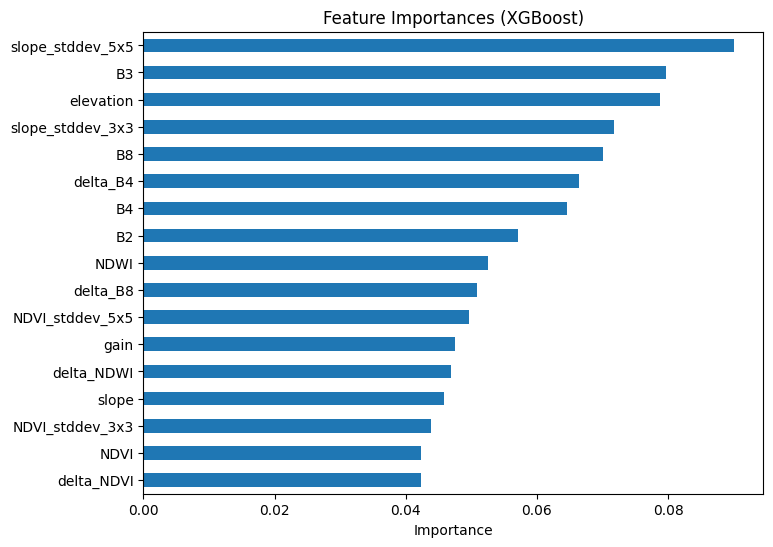

In [190]:
import matplotlib.pyplot as plt
import pandas as pd

# After fitting your best model
importances = model.feature_importances_
feat_names = bands  # same list you used

pd.Series(importances, index=feat_names).sort_values().plot(kind='barh', figsize=(8, 6))
plt.title("Feature Importances (XGBoost)")
plt.xlabel("Importance")
plt.show()

In [194]:
import folium
from folium import plugins

# 🗺️ Create base map
m = folium.Map(location=[52.5, -115], zoom_start=6, tiles='cartodbpositron')

# 📉 Reduce map clutter by using fewer bins
lat_bins = np.linspace(48, 55, 150)  # reduced from 300
lon_bins = np.linspace(-125, -105, 150)

# 📊 Recompute smoothed grid (already have lats, lons, probs from before)
heatmap_grid, _, _ = np.histogram2d(lats, lons, bins=[lat_bins, lon_bins], weights=probs)
counts, _, _ = np.histogram2d(lats, lons, bins=[lat_bins, lon_bins])
avg_probs = np.divide(heatmap_grid, counts, out=np.zeros_like(heatmap_grid), where=counts != 0)
smoothed_probs = gaussian_filter(avg_probs, sigma=1.5)

# 🎯 Updated percentiles for thresholds
t50 = np.percentile(smoothed_probs[smoothed_probs > 0], 50)
t75 = np.percentile(smoothed_probs[smoothed_probs > 0], 75)
t90 = np.percentile(smoothed_probs[smoothed_probs > 0], 90)

# 🎨 Draw cleaner circles
for i in range(smoothed_probs.shape[0]):
    for j in range(smoothed_probs.shape[1]):
        prob = smoothed_probs[i, j]
        if prob > t50:
            lat = (lat_bins[i] + lat_bins[i + 1]) / 2
            lon = (lon_bins[j] + lon_bins[j + 1]) / 2
            radius = 3 + prob * 25  # smaller size

            if prob >= t90:
                color = 'darkred'
            elif prob >= t75:
                color = 'orangered'
            else:
                color = 'orange'

            folium.CircleMarker(
                location=[lat, lon],
                radius=radius,
                color=None,
                fill=True,
                fill_color=color,
                fill_opacity=0.5,
                tooltip=f"Risk: {prob:.2f}"
            ).add_to(m)

# 💾 Save + display
m.save("deforestation_risk_map_cleaner.html")
m
